# AlertAI - Data Visualization
This notebook is responsible showing the data and its features with the goal of improve the knowledge and understanding of the problem that we face.
This work is integrated whitin the pipeline of AlertAI component in RideCare Project.

#### by PEILoad

### The steps of this task are:
1. Import Required Libraries 
2. Acquire the Data
3. Data Visualization


## 1. Import Libraries
This section, as name says, is destined to import the libraries that will be used in the file.

In [2]:
import seaborn as sns
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from sklearn.feature_selection import SelectKBest, chi2, f_classif
import cv2

## 2. Data Acquisition
Step corresponding to gather the Data in order to manipulate it later on.

In [3]:
rawData = pd.read_csv(r'data\raw_data.csv')
stdData = pd.read_csv(r'data\standarized.csv')
normData = pd.read_csv(r'data\minmax.csv')

Removing id columns that might influence the visualization

In [4]:
#Removing id from RawData
rawData = rawData.drop('sensors.id',axis= 1)
# Removing auto index
normData = normData.drop('Unnamed: 0', axis = 1)
stdData = stdData.drop('Unnamed: 0', axis = 1)

KeyError: "['Unnamed: 0'] not found in axis"

## 3. Data Visualization
Where we see whats happening!
Section where the data will be shown and worked to better understand what is in front of us.

#### Dataset Preview

##### Raw Data

In [4]:
print('Number of elements:', rawData.shape[0])
rawData.head()

Number of elements: 2062


,sensors.carId,sensors.carLocation,sensors.timeValue,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.tags,sensors.classification
0,VP-35-44,41.5608 -8.3968,2020-12-07 13:30:07,661.4,1334.4,22.017695,26584,55.019330,1011.466474,14.859670,"Existência de fumo, janelas abertas, AC desligado",1
1,VP-35-44,41.5608 -8.3968,2020-12-07 13:30:02,391.3,514.1,22.019258,25556,55.320447,1011.484612,14.708438,"Existência de fumo, janelas abertas, AC desligado",1
2,VP-35-44,41.5608 -8.3968,2020-12-07 13:29:56,391.3,514.1,22.019648,24783,55.192396,1011.495633,14.616552,"Existência de fumo, janelas abertas, AC desligado",1
3,VP-35-44,41.5608 -8.3968,2020-12-07 13:29:51,391.3,514.1,22.017109,22864,55.230475,1011.505291,14.536031,"Existência de fumo, janelas abertas, AC desligado",1
4,VP-35-44,41.5608 -8.3968,2020-12-07 13:29:45,391.3,514.1,22.013594,22198,55.095559,1011.501234,14.569858,"Existência de fumo, janelas abertas, AC desligado",1


##### Normalized Data

In [5]:
print('Number of elements:', normData.shape[0])
normData.head()

Number of elements: 498


,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
0,0.008609,0.005854,0.565515,0.334227,0.443804,0.275108,0.720586,1.0
1,0.015616,0.011708,0.461692,0.551671,0.526290,0.275318,0.720373,1.0
2,0.015215,0.012108,0.460010,0.543592,0.523150,0.275668,0.720021,1.0
3,0.015115,0.012559,0.458773,0.533588,0.522024,0.275579,0.720110,1.0
4,0.015015,0.011558,0.457576,0.526420,0.524736,0.275606,0.720083,1.0


##### Standarized Data

In [6]:
print('Number of elements:', stdData.shape[0])
stdData.head()

Number of elements: 498


,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
0,-0.204845,-0.215159,0.069011,-1.155241,0.023472,-0.650890,0.645552,2.701851
1,-0.158383,-0.174885,-0.237425,-0.206917,0.318524,-0.650367,0.645023,2.701851
2,-0.161038,-0.172132,-0.242387,-0.242151,0.307292,-0.649499,0.644145,2.701851
3,-0.161702,-0.169034,-0.246039,-0.285781,0.303266,-0.649718,0.644367,2.701851
4,-0.162365,-0.175918,-0.249571,-0.317042,0.312965,-0.649652,0.644300,2.701851


### Infos
The core infos about the data such as: mean, standard deviation, etc. 

##### Raw Data

In [7]:
# Infos from 'Normal Scenario' Data
rawDataNormal = rawData[rawData['sensors.classification']==0]
rawDataNormal.describe()

,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
count,1530.000000,1530.000000,1530.000000,1530.000000,1530.000000,1530.000000,1530.000000,1530.0
mean,6.887843,12.433399,20.431573,50655.024837,49.010644,988.548380,208.730837,0.0
std,7.093866,9.012871,4.246811,12496.094799,10.501339,17.085545,144.932120,0.0
min,0.000000,0.000000,10.512617,9779.000000,25.600421,955.262052,-59.780313,0.0
25%,2.200000,7.025000,18.035029,40524.750000,42.553079,974.112714,118.990220,0.0
50%,4.500000,10.300000,20.824141,55955.500000,48.610579,990.046460,195.001528,0.0
75%,9.200000,14.275000,24.026924,60075.250000,56.501340,999.039430,331.062110,0.0
max,41.600000,52.700000,27.949531,68118.000000,72.686949,1020.450858,494.377666,0.0


In [8]:
# Infos from 'Anomaly Scenario' Data
rawDataAnomaly = rawData[rawData['sensors.classification']>0]
rawDataAnomaly.describe()

,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
count,532.000000,532.000000,532.000000,532.000000,532.000000,532.000000,532.000000,532.0
mean,435.720865,796.131015,18.204949,26721.716165,60.358144,1008.564616,39.377654,1.0
std,242.600065,511.758778,2.049690,12093.884448,5.422557,9.288305,78.796258,0.0
min,0.000000,0.000000,11.200313,3841.000000,49.369326,967.816309,5.684227,1.0
25%,213.100000,383.200000,17.177119,18521.750000,56.223787,1009.039051,10.977083,1.0
50%,440.500000,670.700000,18.362617,26354.500000,61.051800,1011.106052,17.865142,1.0
75%,609.200000,1136.300000,19.554170,32558.000000,64.455652,1011.932234,35.118169,1.0
max,999.900000,1999.900000,22.019648,69055.000000,71.766466,1012.567452,385.325117,1.0


##### normalized Data

In [9]:
normData.describe()

,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
count,498.000000,498.000000,498.000000,498.000000,498.000000,498.000000,498.000000,498.000000
mean,0.039502,0.037129,0.542133,0.599115,0.437242,0.537064,0.461074,0.120482
std,0.150964,0.145505,0.339150,0.229523,0.279848,0.402864,0.402404,0.325852
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.005305,0.004553,0.139778,0.475127,0.213319,0.121706,0.068454,0.000000
50%,0.007107,0.005854,0.589185,0.525285,0.297390,0.894059,0.103936,0.000000
75%,0.010686,0.007443,0.856056,0.849225,0.735073,0.930172,0.875975,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


##### Standarized Data

In [10]:
stdData.describe()

,sensors.pm25,sensors.pm10,sensors.temperature,sensors.gas,sensors.humidity,sensors.pressure,sensors.altitude,sensors.classification
count,4.980000e+02,4.980000e+02,4.980000e+02,4.980000e+02,4.980000e+02,4.980000e+02,498.000000,498.000000
mean,-7.133963e-17,1.426793e-17,-2.282868e-16,-1.712151e-16,6.277888e-16,-2.682370e-15,0.000000,0.000000
std,1.001006e+00,1.001006e+00,1.001006e+00,1.001006e+00,1.001006e+00,1.001006e+00,1.001006,1.001006
min,-2.619263e-01,-2.554323e-01,-1.600113e+00,-2.612887e+00,-1.563998e+00,-1.334457e+00,-1.146951,-0.370117
25%,-2.267481e-01,-2.241085e-01,-1.187555e+00,-5.407419e-01,-8.009645e-01,-1.032052e+00,-0.976666,-0.370117
50%,-2.148008e-01,-2.151588e-01,1.388721e-01,-3.219901e-01,-5.002432e-01,8.870333e-01,-0.888404,-0.370117
75%,-1.910722e-01,-2.042299e-01,9.265457e-01,1.090789e+00,1.065333e+00,9.767647e-01,1.032090,-0.370117
max,6.368825e+00,6.624101e+00,1.351398e+00,1.748356e+00,2.012968e+00,1.150268e+00,1.340611,2.701851


### Plots
Analyzing plots is one of the best way to see the variations of the data 

#### Pairplots

##### Raw Data

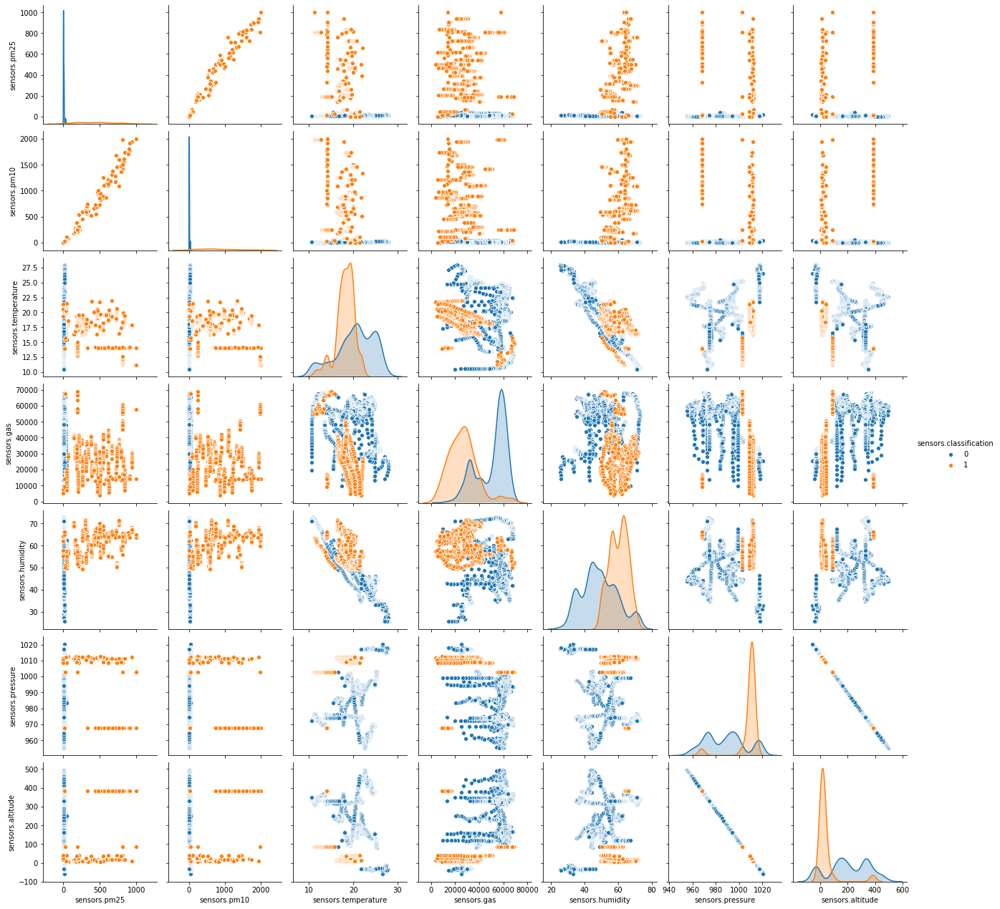

In [11]:
plot = sns.pairplot(hue='sensors.classification',data=rawData)
#plot.savefig(r'C:\Users\JCost\OneDrive\Ambiente de Trabalho\PEI\PPT_09-12-2020\pairplot.png') #Save the plot as png

##### Normalized Data

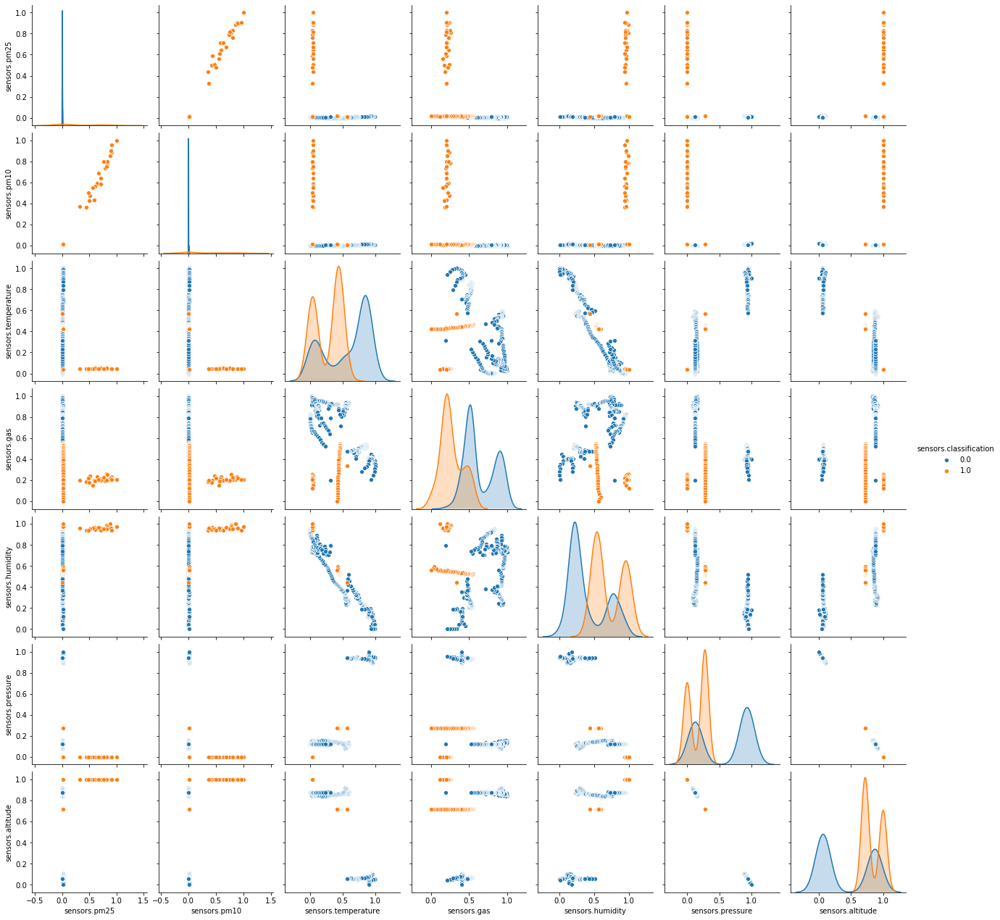

In [12]:
sns.pairplot(hue='sensors.classification',data=normData)

##### Standarized Data

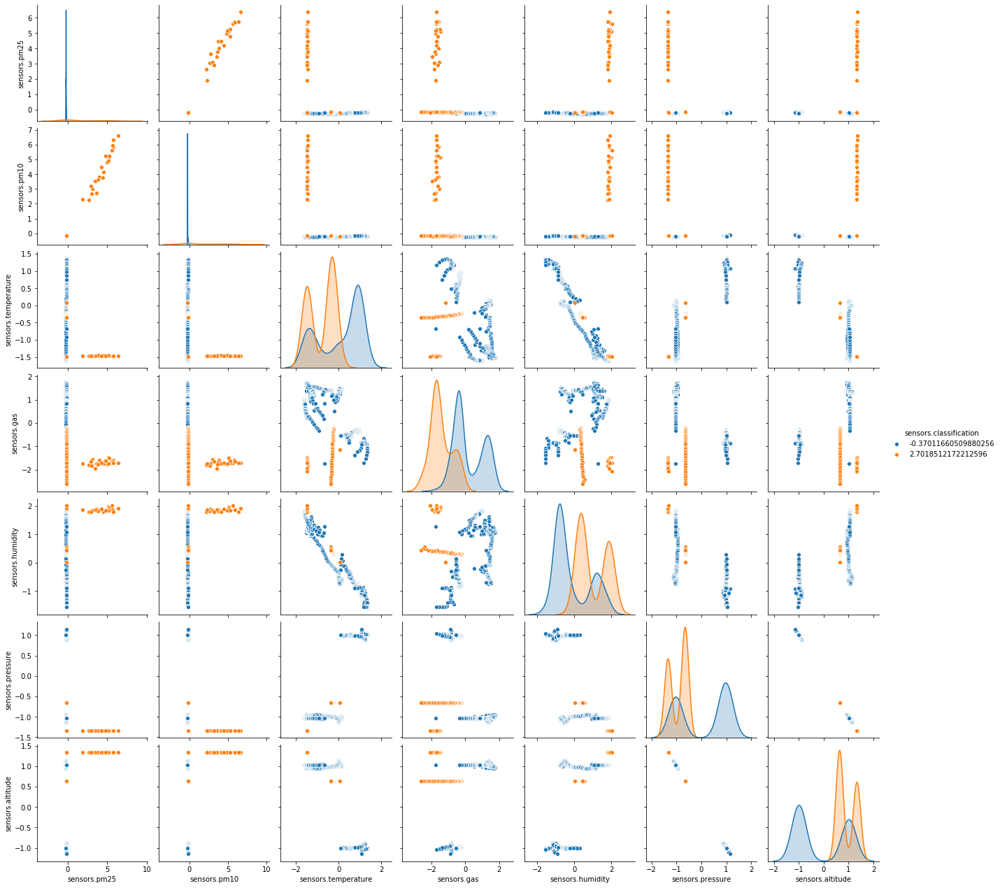

In [13]:
sns.pairplot(hue='sensors.classification',data=stdData)

#### Feature Correlation heatmap

##### Raw Data

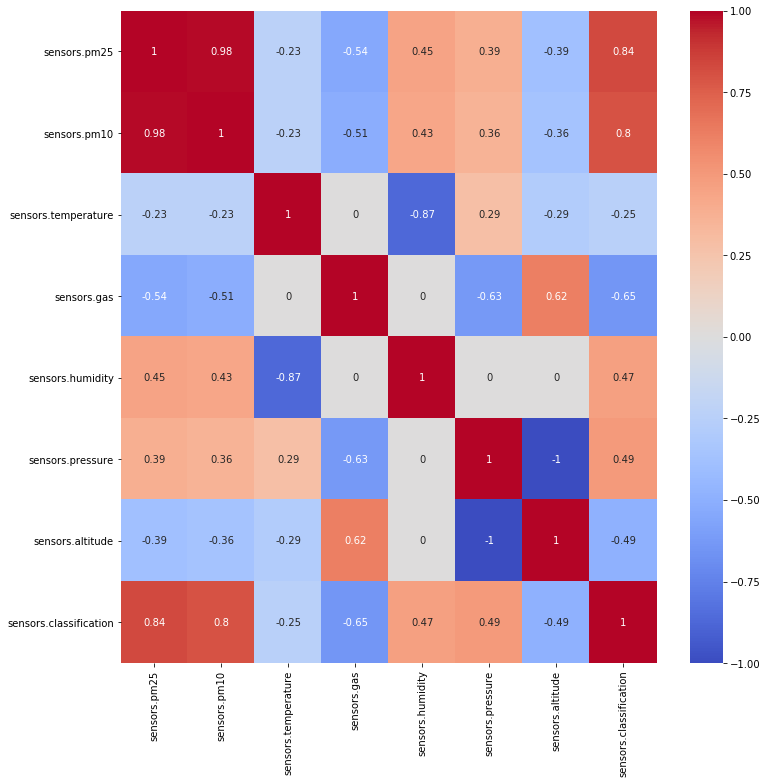

In [18]:
plt.figure(figsize=(12,12))

rawCorrMatrix = rawData.corr()
rawCorrMatrix[np.abs(rawCorrMatrix)<.2] = 0
heat = sns.heatmap(rawCorrMatrix,
            vmin=-1,
            cmap="coolwarm",
            annot=True)
#heat.figure.savefig(r'C:\Users\JCost\OneDrive\Ambiente de Trabalho\PEI\PPT_09-12-2020\heat.png') #Save the plot as png

##### Normalized Data

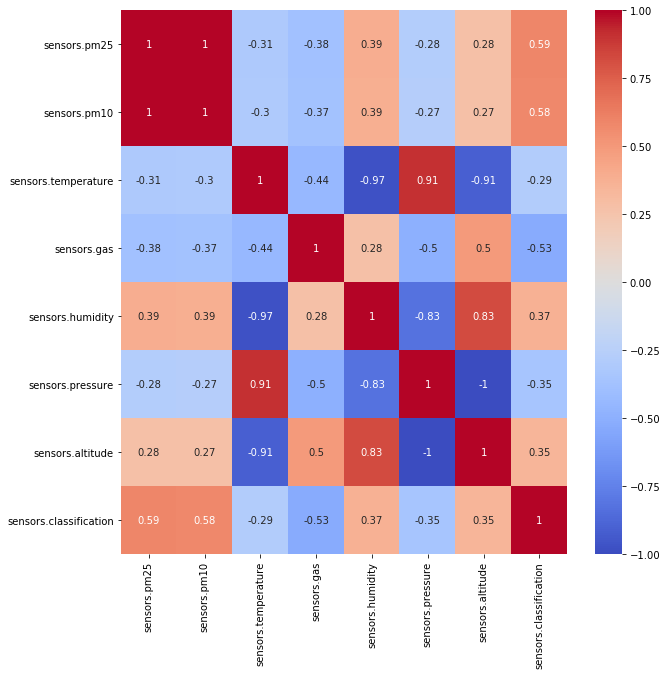

In [15]:
plt.figure(figsize=(10,10))

normCorrMatrix = normData.corr()
sns.heatmap(normCorrMatrix,
            vmin=-1,
            cmap="coolwarm",
            annot=True)

##### Standarized Data

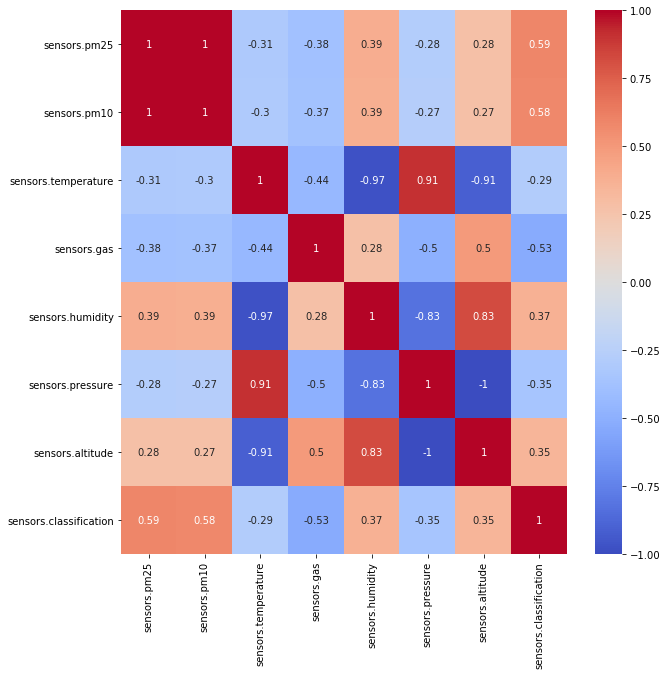

In [16]:
plt.figure(figsize=(10,10))

stdCorrMatrix = stdData.corr()
sns.heatmap(stdCorrMatrix,
            vmin=-1,
            cmap="coolwarm",
            annot=True)

#### Feature Importance for prediction

##### Raw Data

In [19]:
K = 3 # number of features to select
Y = rawData['sensors.classification']
X = rawData.drop(['sensors.classification','sensors.carId','sensors.carLocation','sensors.timeValue','sensors.tags'], axis=1)
allFeaturesRaw = (X.columns.values)

kBestRaw = SelectKBest(f_classif, k=K).fit(X, Y)
kBestIndexRaw = kBestRaw.get_support()
kBestFeaturesRaw = allFeaturesRaw[kBestIndexRaw]
print('The best',K, 'Feature(s):')
for i,col in enumerate(kBestFeaturesRaw):
    print(' -',col)

The best 3 Feature(s):
 - sensors.pm25
 - sensors.pm10
 - sensors.gas


##### Normalized Data

In [20]:
K = 3 # number of features to select
Y = normData['sensors.classification']
X = normData.drop(['sensors.classification'], axis=1)
allFeaturesNorm = (X.columns.values)

kBestNorm = SelectKBest(chi2, k=K).fit(X, Y)
kBestIndexNorm = kBestNorm.get_support()
kBestFeaturesNorm = allFeaturesNorm[kBestIndexNorm]
print('The best',K, 'Feature(s):')
for i,col in enumerate(kBestFeaturesNorm):
    print(' -',col)

The best 3 Feature(s):
 - sensors.pm25
 - sensors.pm10
 - sensors.altitude


##### Standarized Data

In [21]:
K = 3 # number of features to select
Y = stdData['sensors.classification']
X = stdData.drop(['sensors.classification'], axis=1)
allFeaturesStd = (X.columns.values)

kBestStd = SelectKBest(f_classif, k=K).fit(X, Y)
kBestIndexStd = kBestStd.get_support()
kBestFeaturesStd = allFeaturesStd[kBestIndexStd]
print('The best',K, 'Feature(s):')
for i,col in enumerate(kBestFeaturesStd):
    print(' -',col)

The best 3 Feature(s):
 - sensors.pm25
 - sensors.pm10
 - sensors.gas


#### Scatters of the K best features

##### Raw Data

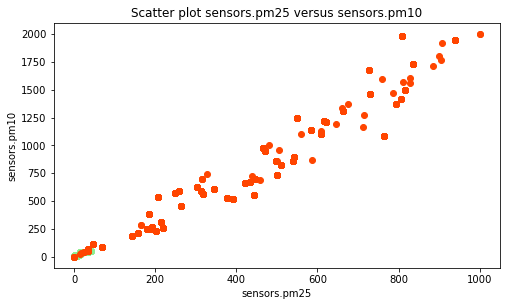

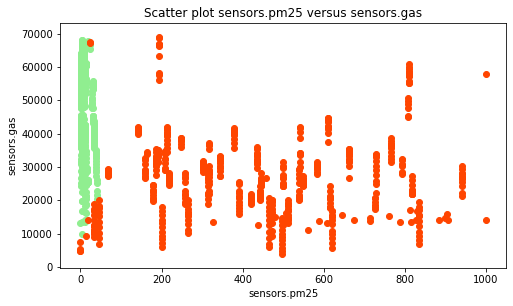

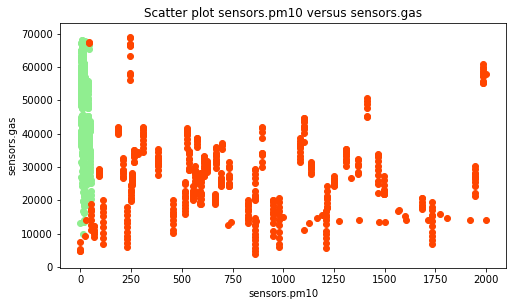

In [22]:
allRaw0 = rawData[rawData['sensors.classification'] == 0]
allRaw1 = rawData[rawData['sensors.classification'] == 1]

scatterRaw0 = allRaw0[kBestFeaturesRaw]
scatterRaw1 = allRaw1[kBestFeaturesRaw]

for i1,feat1 in enumerate(kBestFeaturesRaw):
    for i2,feat2 in enumerate(kBestFeaturesRaw):
        if(i1 >= i2):
            ;
        else:
            plt.figure(figsize=(8,4.5))
            plt.scatter(scatterRaw0[feat1],scatterRaw0[feat2],c='lightgreen')
            plt.scatter(scatterRaw1[feat1],scatterRaw1[feat2],c='orangered')
            plt.xlabel(feat1)
            plt.ylabel(feat2)
            plt.title('Scatter plot ' + feat1 + ' versus ' + feat2)
            plt.show()

##### Normalized Data

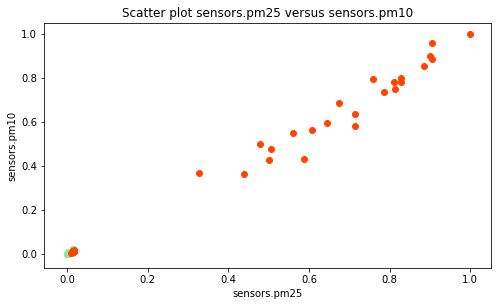

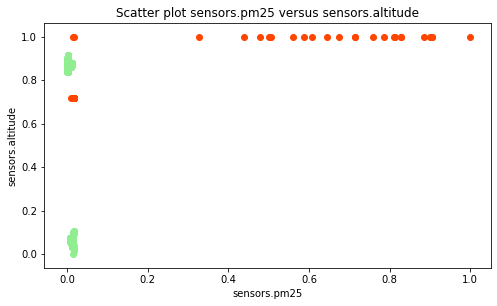

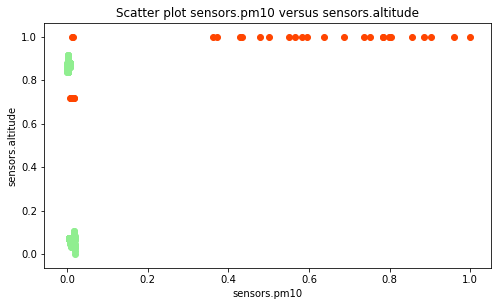

In [23]:
allNorm0 = normData[normData['sensors.classification'] == 0]
allNorm1 = normData[normData['sensors.classification'] == 1]

scatter0Norm = allNorm0[kBestFeaturesNorm]
scatter1Norm = allNorm1[kBestFeaturesNorm]

for i1,feat1 in enumerate(kBestFeaturesNorm):
    for i2,feat2 in enumerate(kBestFeaturesNorm):
        if(i1 >= i2):
            ;
        else:
            plt.figure(figsize=(8,4.5))
            plt.scatter(scatter0Norm[feat1],scatter0Norm[feat2],c='lightgreen')
            plt.scatter(scatter1Norm[feat1],scatter1Norm[feat2],c='orangered')
            plt.xlabel(feat1)
            plt.ylabel(feat2)
            plt.title('Scatter plot ' + feat1 + ' versus ' + feat2)
            plt.show()

##### Standarized Data

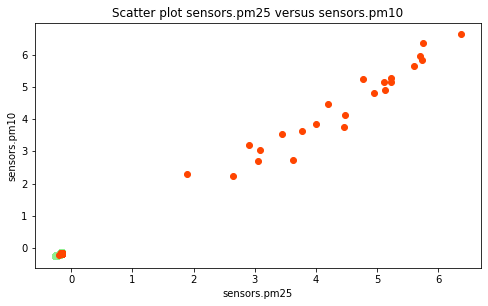

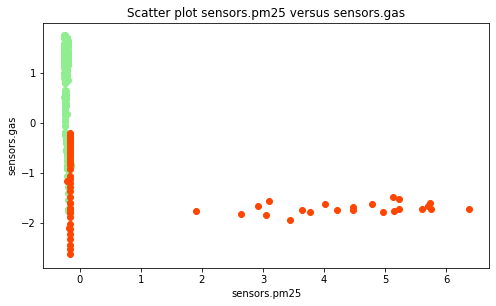

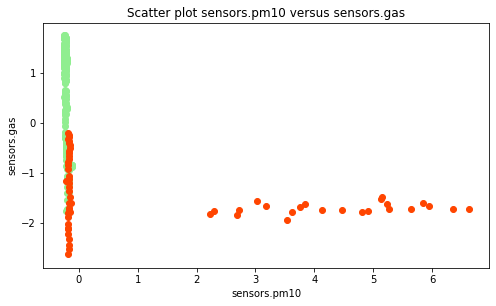

In [24]:
allStd0 = stdData[stdData['sensors.classification'] < 0]
allStd1 = stdData[stdData['sensors.classification'] >= 0]

scatter0Std = allStd0[kBestFeaturesStd]
scatter1Std = allStd1[kBestFeaturesStd]

for i1,feat1 in enumerate(kBestFeaturesStd):
    for i2,feat2 in enumerate(kBestFeaturesStd):
        if(i1 >= i2):
            ;
        else:
            plt.figure(figsize=(8,4.5))
            plt.scatter(scatter0Std[feat1],scatter0Std[feat2],c='lightgreen')
            plt.scatter(scatter1Std[feat1],scatter1Std[feat2],c='orangered')
            plt.xlabel(feat1)
            plt.ylabel(feat2)
            plt.title('Scatter plot ' + feat1 + ' versus ' + feat2)
            plt.show()


### TEMP

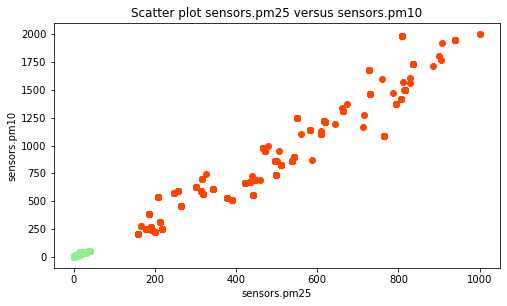

In [6]:
tmp = pd.read_csv(r'data\data.csv')
tmp0 = tmp[tmp['sensors.classification'] == 0]
tmp1 = tmp[tmp['sensors.classification'] == 1]
plt.figure(figsize=(8,4.5))
plt.scatter(tmp0['sensors.pm25'],tmp0['sensors.pm10'],c='lightgreen')
plt.scatter(tmp1['sensors.pm25'],tmp1['sensors.pm10'],c='orangered')
plt.xlabel('sensors.pm25')
plt.ylabel('sensors.pm10')
plt.title('Scatter plot ' + 'sensors.pm25' + ' versus ' + 'sensors.pm10')
plt.show()